# 1. Theory

## 1.1 Introduction
The SIR model is a fundamental compartmental model in epidemiology, used to describe the spread of infectious diseases in a closed population. This document presents the governing differential equations, key analytical
insights, and approaches to solving the system, including numerical methods. The model divides the population into
susceptible, infected, and recovered compartments, and we derive properties such as the basic reproduction number,
equilibrium points, and the final epidemic size.


### 1.2 SIR model

The SIR model divides a population of size N into three compartments: Susceptible ($S$), Infected ($I$), and Recovered
($R$). The population is assumed to be closed ($S + I + R= N$, constant), with no births, deaths, or migration. The model
is governed by a system of nonlinear ordinary differential equations, which we present and analyze below.


### 1.3 Governing Equations

The dynamics of the SIR model are described by the following system of differential equations:
$$
\begin{align}
\frac{dS}{dt} &= -\beta \frac{SI}{N} \quad \quad \quad \quad &(1)
\\
\frac{dI}{dt} &= \beta \frac{SI}{N} - \gamma I \quad \quad \quad \quad &(2)
\\
\frac{dR}{dt} &= \gamma I \quad \quad \quad \quad &(3)
\end{align}
$$
where $\beta$ and $\gamma$ are adjustable parameters.

## 1.4 Analytical Insights

The nonlinear term $SI$ makes exact analytical solutions challenging. However, we can derive important properties of
the system.


### 1.4.1 Basic Reproduction Number
The basic reproduction number, $r$, represents the average number of secondary infections caused by one infected
individual in a fully susceptible population ($S \approx N$). From equation (2):
$$
\frac{dI}{dt} = \left ( \beta \frac{S}{N}-\gamma \right ) I \approx (\beta - \gamma)I \quad (\text{when } S\approx N)
$$
The epidemic grows if $\beta - \gamma>0$, i.e. $\beta/\gamma>1$. Thus:
$$
r = \frac{\beta}{\gamma}
$$
If $r>1$, the epidemic grows initially; if $r<1$, it dies out.

### 1.4.2 Equilibrium Points
To find equilibrium points, set the derivatives to zero:


*   From (1): $-\beta \frac{SI}{N}=0 \Rightarrow SI=0 \Rightarrow S=0 \text{ or } I=0$.
*   From (2): $\beta \frac{SI}{N}-\gamma I=0 \Rightarrow I(\beta \frac{S}{N}-\gamma)=0 \Rightarrow I=0 \text{ or } S=\frac{\gamma N}{\beta}=\frac{N}{r}$
*   From (3): $\gamma I=0 \Rightarrow I=0$

The equilibria are:


*   **Disease-free equilibrium:** $(S,I,R)=(N,0,0)$



### 1.4.3 Phase Plane Analysis
To study the dynamics, consider the relationship between $S$ and $I$. Divide (2) by (1):

$$
\frac{\frac{dI}{dt}}{\frac{dS}{dt}} = \frac{\beta \frac{SI}{N} - \gamma I}{-\beta \frac{SI}{N}} = \frac{\beta \frac{S}{N} - \gamma}{-\beta \frac{S}{N}} = -1 + \frac{\gamma N}{\beta S}.
$$

Thus:

$$
\frac{dI}{dS} = -1 + \frac{\gamma N}{\beta S} = -1 + \frac{1}{r \frac{S}{N}}.
$$

Separate variables and integrate:

$$
\int dI = \int \left( -1 + \frac{\gamma N}{\beta S} \right) dS.
$$

$$
I = -S + \frac{\gamma N}{\beta} \ln S + C = -S + \frac{N}{r} \ln S + C.
$$

Using initial conditions $S(0) = S_0$, $I(0) = I_0$, $R(0) = 0$:

$$
C = I_0 + S_0 - \frac{N}{r} \ln S_0.
$$

So:

$$
I = -S + \frac{N}{r} \ln S + I_0 + S_0 - \frac{N}{r} \ln S_0.
$$

The epidemic peaks when $\frac{dI}{dt} = 0$:

$$
\beta \frac{S}{N} - \gamma = 0 \implies S = \frac{\gamma N}{\beta} = \frac{N}{r}.
$$

### 1.4.4 Final Epidemic Size

To find the final number of susceptibles ($S_{\infty}$) when $I_{\infty} = 0$, use (1) and (3). From (3), $I = \frac{1}{\gamma} \frac{dR}{dt}$. Substitute into (1):

$$
\begin{align}
\frac{dS}{dt} &= -\beta \frac{S}{N} \cdot \frac{1}{\gamma} \frac{dR}{dt}.
\\
\frac{dS}{dR} &= -\frac{\beta}{\gamma N} S = -\frac{r}{N} S.
\end{align}
$$

Integrate from $R = 0$ to $R_{\infty}$, $S = S_0$ to $S_{\infty}$:

$$
\int_{S_0}^{S_{\infty}} \frac{dS}{S} = -\frac{r}{N} \int_{0}^{R_{\infty}} dR.
$$

$$
\ln S_{\infty} - \ln S_0 = -\frac{r}{N} R_{\infty}.
$$

$$
S_{\infty} = S_0 e^{-\frac{r}{N} R_{\infty}}.
$$

Since $S_{\infty} + R_{\infty} = N$ (assuming $I_0 \approx 0$, $R_0 = 0$, $S_0 \approx N$):

$$
S_{\infty} = Ne^{-\frac{r}{N} (N - S_{\infty})}.
$$

This transcendental equation must be solved numerically to find $S_{\infty}$.


## 1.5 Numerical Solution

Due to the nonlinearity of the SIR model, exact solutions are generally not possible in terms of elementary functions. Numerical methods, such as the 4th-order Runge-Kutta method, are commonly used. The system is solved with initial conditions (e.g., $S_0 = 990$, $I_0 = 10$, $R_0 = 0$) and parameters (e.g., $\beta = 0.3$, $\gamma = 0.1$). The algorithm approximates the solution at discrete time steps, producing curves for $S(t)$, $I(t)$, and $R(t)$.

## 1.6 Conclusion

The SIR model provides a framework for understanding disease dynamics. Key insights include the role of $r = \beta / \gamma$ in determining epidemic growth, the peak infection at $S = N/r$, and the final epidemic size via the transcendental equation. Numerical methods are essential for practical solutions, and extensions (e.g., SEIR model) can address additional complexities.

# 2. Project

In [ ]:
# import neccessary packages
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp
import matplotlib.animation as animation
from matplotlib.colors import ListedColormap, BoundaryNorm
from IPython.display import Image
from scipy.ndimage import convolve
from numba import njit, typed


# a function to plot evolution of SIR compartments over time
def plot(time,
         sArray,
         iArray,
         rArray,
         xlabel,
         title):
    plt.plot(time, sArray, label='Susceptible')
    plt.plot(time, iArray, label='Infectious')
    plt.plot(time, rArray, label='Recovered')
    plt.xlabel(xlabel)
    plt.ylabel('Fraction of population')
    plt.legend()
    plt.title(title)
    plt.show()

##### SIR Parameters

In [ ]:
"""
-----------------------------------------------------
constants of the SIR model
-----------------------------------------------------
"""
# default
beta = 0.5 # infection rate
gamma = 0.05 # recovery rate

# measles
# beta = 2.145
# gamma = 0.143

#basic reproduction number
r_0 = beta/gamma

"""
-----------------------------------------------------
constants of the simulation
-----------------------------------------------------
"""

L = 1000  # size of simulation lattice
N = L * L  # size of population

I0 = int(0.001 * N)  # initial number of infected people (0.1% of population)
R0 = 0  # initial number of recovered people
S0 = N - I0 - R0  # initial number of susceptible people

steps = 100  # number of time steps
t_start = 0  # initial time (days)
t_finish = 100  # ending time of simulation (days)
time = np.linspace(t_start, t_finish, steps)

## 2.1 Numerical solution

### Code

In [ ]:
"""
-----------------------------------------------------------------------------------------
evolution equations for SIR model
-----------------------------------------------------------------------------------------
"""


def SIR_equations(t, y, N, beta, gamma):
    # y = [S, I, R] at time t
    S, I, R = y
    dSdt = (
        -beta / N * I * S
    )  # derivative of susceptible with respect to time (loss by S->I transition)
    dIdt = (
        beta / N * I * S - gamma * I
    )  # derivative of infectious with respect to time (gain by S->I transition, loss by I->R transition)
    dRdt = (
        gamma * I
    )  # derivative of recovered with respect to time (gain by I->R transition)
    return [dSdt, dIdt, dRdt]

In [ ]:
"""
-----------------------------------------------------------------------------------------
runge-Kutta method of order 2
-----------------------------------------------------------------------------------------
"""


def runge_kutta_2_method(func, initial, t_start, t_finish, steps, args=()):
    # Calculate the time step
    dt = (t_finish - t_start) / steps

    # Generate an array of time points
    tArray = np.linspace(t_start, t_finish, steps)

    # List to store the solution at each time step
    data = []

    # Initialize the state as a float array
    state = np.array(initial, dtype=float)
    data.append(state) # Add the initial state to the data list

    # Main loop for RK2 integration
    for i in range(1, steps):
        t = tArray[i - 1] # Current time value

        # First approximation of the derivative (Euler's method)
        func1 = np.array(func(t, state, *args))

        # Second approximation (midpoint method)
        func2 = np.array(func(t + dt / 2, state + dt / 2 * func1, *args))

        # Update the state using the second derivative estimate
        state = state + dt * func2

        # Store the new state
        data.append(state)

    # Return the array of all states and the corresponding time points
    return np.array(data), tArray

In [ ]:
"""
----------------------------------------------------------------------------------------------------
solving SIR model equations with scipy.integrate.solve_ivp
----------------------------------------------------------------------------------------------------
"""

eq_sol = solve_ivp(
    SIR_equations, [0, steps], [S0, I0, R0], args=(N, beta, gamma), t_eval=time,
)

tArray_ivp = eq_sol.t
sArray_ivp, iArray_ivp, rArray_ivp = eq_sol.y

In [ ]:
"""
----------------------------------------------------------------------------------------------------
solving SIR model equations with own implementation of runge-Kutta method
----------------------------------------------------------------------------------------------------
"""
eq_sol, tArray_RK = runge_kutta_2_method(
    SIR_equations, [S0, I0, R0], 0, 100, steps=100, args=(N, beta, gamma)
)


# Extracting the results from the numerical solution
sArray_RK = eq_sol[:, 0]
iArray_RK = eq_sol[:, 1]
rArray_RK = eq_sol[:, 2]

### Plots

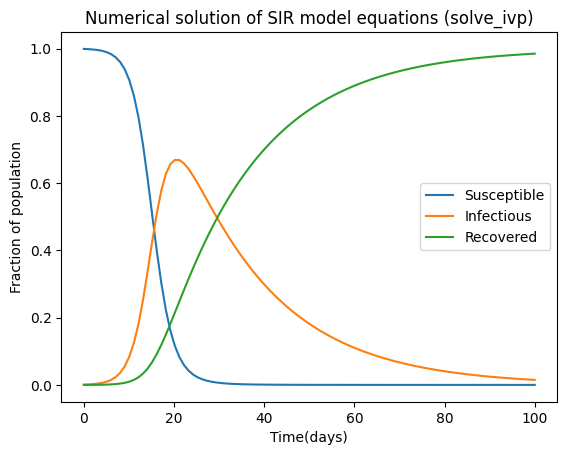

In [ ]:
plot(
    tArray_ivp,
    sArray_ivp / N,
    iArray_ivp / N,
    rArray_ivp / N,
    "Time(days)",
    "Numerical solution of SIR model equations (solve_ivp)",
)

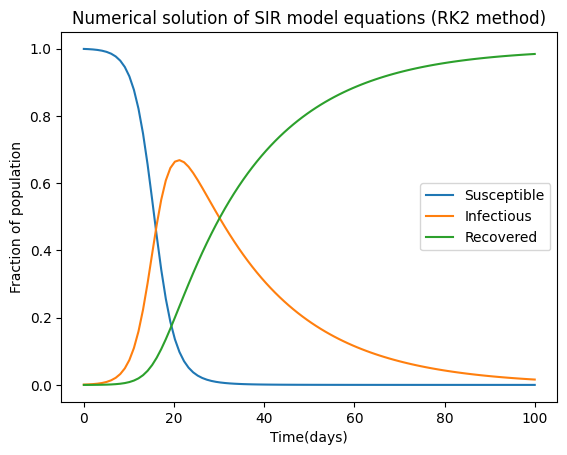

In [ ]:
plot(
    tArray_RK,
    sArray_RK / N,
    iArray_RK / N,
    rArray_RK / N,
    "Time(days)",
    "Numerical solution of SIR model equations (RK2 method)",
)

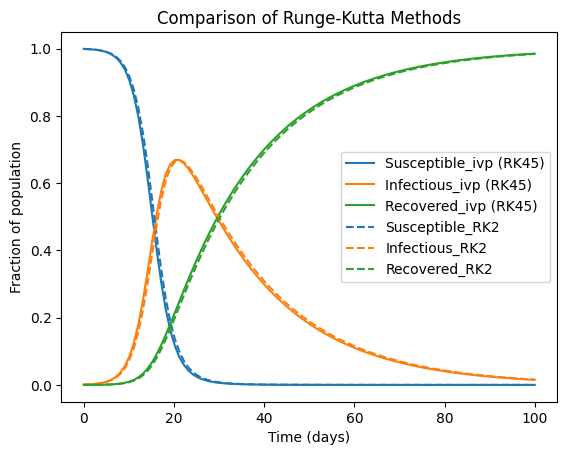

In [ ]:
plt.plot(tArray_ivp, sArray_ivp / N, label="Susceptible_ivp (RK45)", color="tab:blue", linestyle='-')
plt.plot(tArray_ivp, iArray_ivp / N, label="Infectious_ivp (RK45)", color="tab:orange", linestyle='-')
plt.plot(tArray_ivp, rArray_ivp / N, label="Recovered_ivp (RK45)", color="tab:green", linestyle='-')

plt.plot(tArray_ivp, sArray_RK / N, label="Susceptible_RK2", color="tab:blue", linestyle='--')
plt.plot(tArray_ivp, iArray_RK / N, label="Infectious_RK2", color="tab:orange", linestyle='--')
plt.plot(tArray_ivp, rArray_RK / N, label="Recovered_RK2", color="tab:green", linestyle='--')

# plot options
plt.xlabel("Time (days)")
plt.ylabel("Fraction of population")
plt.title("Comparison of Runge-Kutta Methods")
plt.legend()
plt.show()

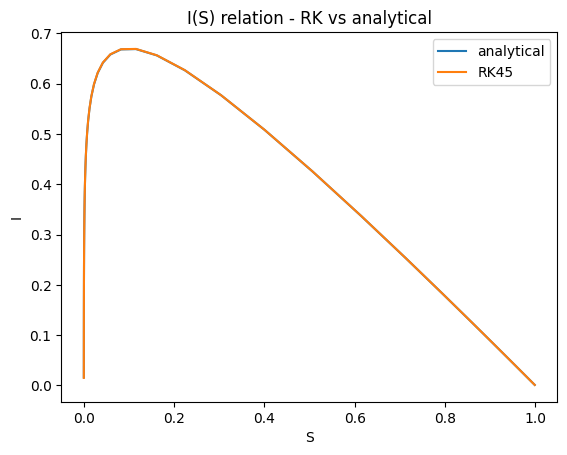

In [ ]:
'''
----------------------------------------------------------------------------------------------------
comparing results of numerical solutions with analytical solution: I(S)
----------------------------------------------------------------------------------------------------
'''

plt.plot(sArray_ivp/N,(  -sArray_ivp + N/r_0* np.log(sArray_ivp) + iArray_ivp[0] + sArray_ivp[0] - N/r_0 *np.log(sArray_ivp[0]))/N, label="analytical")
plt.plot(sArray_ivp/N,iArray_ivp/N, label="RK45")
plt.xlabel("S")
plt.ylabel("I")
plt.title(r"I(S) relation - RK vs analytical")
plt.legend()
plt.show()

## 2.2 Solver: Agent Model

### Description

First we simulate the SIR problem using an array of agents. During a time step of the simulation each susceptible agent can become infected with probability equal to $\beta I/N$, where $I$ is the number of infected agents at that time, and each infected agent can recover with a probability equal to the $\gamma$ parameter.

### Code

In [ ]:
def simulate_agent_model(N, I0, beta, gamma, t_start, t_finish):
    """
    A simulation - agent-based model with global contact

    Parameters:
    - N: number of agents
    - I0: number of infectious agents at the begining
    - beta: infection coefficient
    - gamma: recovery coefficient
    - t_start: selfcommented
    - t_finish: selfcommented

    Return:
    - sArray: number of susceptible in time
    - iArray: number of infectious in time
    - rArray: number of recovered in time
    """

    # initialize list of agents
    agents = np.zeros(N, dtype=int)
    # initialize infected
    agents[:I0] = 1
    # initialize history of simulation states
    historyOfAgents = []

    # get number of simulation steps
    steps = int((t_finish - t_start))

    # simulation loop
    for step in range(steps):

        # save current state to history
        historyOfAgents.append(agents.copy())

        # get infected and susceptible agents
        infected = agents == 1
        susceptible = agents == 0

        # get probability of infection (beta*I/N)
        prob_infection = beta * np.sum(infected) / N

        # for each susceptible agent randomly convert to infectious (with probability of infection)
        # for each infectious agent randomly convert to recovered (with probability the gamma parameter)
        new_infections = (np.random.rand(N) < prob_infection) & susceptible
        recoveries = (np.random.rand(N) < gamma) & infected

        agents[new_infections] = 1
        agents[recoveries] = 2

    # convert history of simulation into history of changes in SIR compartments and return the latter
    sArray, iArray, rArray = [], [], []

    for agents in historyOfAgents:
        sArray.append(np.count_nonzero(agents == 0))
        iArray.append(np.count_nonzero(agents == 1))
        rArray.append(np.count_nonzero(agents == 2))

    return np.array(sArray), np.array(iArray), np.array(rArray)

def simulate_agent_model_sub_steps(N, I0, beta, gamma, t_start, t_finish, num_of_sub_steps=10):
    """
    A simulation - agent-based model with global contact

    Parameters:
    - N: number of agents
    - I0: number of infectious agents at the begining
    - beta: infection coefficient
    - gamma: recovery coefficient
    - t_start: selfcommented
    - t_finish: selfcommented
    - num_of_sub_steps: number of sub-steps in each time step

    Return:
    - sArray: number of susceptible in time
    - iArray: number of infectious in time
    - rArray: number of recovered in time
    """

    # initialize list of agents
    agents = np.zeros(N, dtype=int)
    # initialize infected
    agents[:I0] = 1
    # initialize history of simulation states
    historyOfAgents = []

    # get number of simulation steps
    steps = int((t_finish - t_start))

    beta = beta / num_of_sub_steps  # adjust beta for sub-steps
    gamma = gamma / num_of_sub_steps  # adjust gamma for sub-steps
    # simulation loop
    for step in range(steps):
        for sub_step in range(num_of_sub_steps):

            # get infected and susceptible agents
            infected = agents == 1
            susceptible = agents == 0

            # get probability of infection (beta*I/N)
            prob_infection = beta * np.sum(infected) / N

            # for each susceptible agent randomly convert to infectious (with probability of infection)
            # for each infectious agent randomly convert to recovered (with probability the gamma parameter)
            new_infections = (np.random.rand(N) < prob_infection) & susceptible
            recoveries = (np.random.rand(N) < gamma) & infected

            agents[new_infections] = 1
            agents[recoveries] = 2
        # save current state to history
        historyOfAgents.append(agents.copy())

        # get infected and susceptible agents
        infected = agents == 1
        susceptible = agents == 0

        # get probability of infection (beta*I/N)
        prob_infection = beta * np.sum(infected) / N

        # for each susceptible agent randomly convert to infectious (with probability of infection)
        # for each infectious agent randomly convert to recovered (with probability the gamma parameter)
        new_infections = (np.random.rand(N) < prob_infection) & susceptible
        recoveries = (np.random.rand(N) < gamma) & infected

        agents[new_infections] = 1
        agents[recoveries] = 2

    # convert history of simulation into history of changes in SIR compartments and return the latter
    sArray, iArray, rArray = [], [], []

    for agents in historyOfAgents:
        sArray.append(np.count_nonzero(agents == 0))
        iArray.append(np.count_nonzero(agents == 1))
        rArray.append(np.count_nonzero(agents == 2))

    return np.array(sArray), np.array(iArray), np.array(rArray)

In [ ]:
sArray, iArray, rArray = simulate_agent_model(N, I0, beta, gamma, t_start, t_finish)

### Results

#### Plots

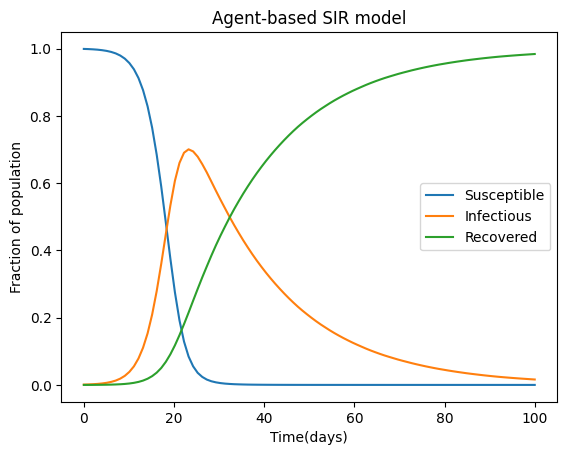

In [ ]:
plot(time, sArray / N, iArray / N, rArray / N, "Time(days)", "Agent-based SIR model")

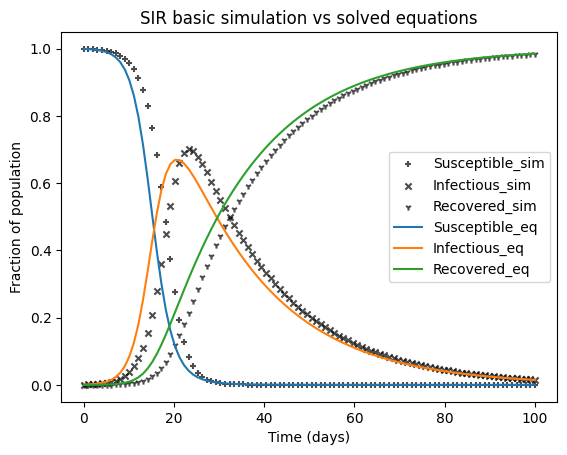

In [ ]:
"""
-----------------------------------------------------------------------------------------------
comparing results of agent-based model with global contact simulation with numerical solution
-----------------------------------------------------------------------------------------------
"""

# simulation results
plt.scatter(time, sArray / N, label="Susceptible_sim", marker="+", c="k", alpha=0.7, s=20)
plt.scatter(time, iArray / N, label="Infectious_sim", marker="x", c="k", alpha=0.7, s=20)
plt.scatter(time, rArray / N, label="Recovered_sim", marker="1", c="k", alpha=0.7, s=20)


# numerical solution
plt.plot(tArray_ivp, sArray_ivp / N, label="Susceptible_eq")
plt.plot(tArray_ivp, iArray_ivp / N, label="Infectious_eq")
plt.plot(tArray_ivp, rArray_ivp / N, label="Recovered_eq")


# plot options
plt.xlabel("Time (days)")
plt.ylabel("Fraction of population")
plt.title("SIR basic simulation vs solved equations")
plt.legend()
plt.show()

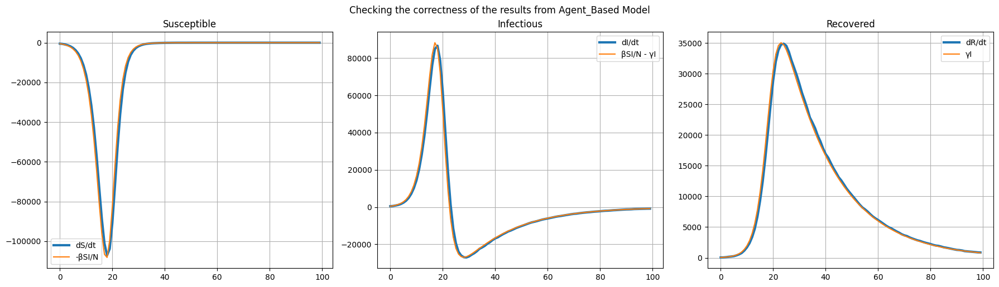

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# S - Susceptible
axes[0].plot(np.gradient(sArray), label="dS/dt", linewidth=3)
axes[0].plot(-beta * sArray * iArray / N, label="-βSI/N")
axes[0].set_title("Susceptible")
axes[0].legend()
axes[0].grid(True)

# I - Infected
axes[1].plot(np.gradient(iArray), label="dI/dt", linewidth=3)
axes[1].plot(beta * sArray * iArray / N - gamma * iArray, label="βSI/N - γI")
axes[1].set_title("Infectious")
axes[1].legend()
axes[1].grid(True)

# R - Recovered
axes[2].plot(np.gradient(rArray), label="dR/dt", linewidth=3)
axes[2].plot(gamma * iArray, label="γI")
axes[2].set_title("Recovered")
axes[2].legend()
axes[2].grid(True)

plt.tight_layout()
plt.suptitle("Checking the correctness of the results from Agent_Based Model", y=1.02)
plt.show()

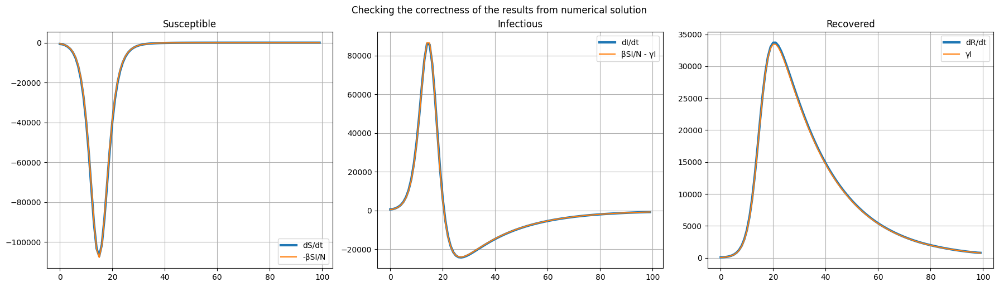

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# S - Susceptible
axes[0].plot(np.gradient(sArray_ivp), label="dS/dt", linewidth=3)
axes[0].plot(-beta * sArray_ivp * iArray_ivp / N, label="-βSI/N")
axes[0].set_title("Susceptible")
axes[0].legend()
axes[0].grid(True)

# I - Infected
axes[1].plot(np.gradient(iArray_ivp), label="dI/dt", linewidth=3)
axes[1].plot(beta * sArray_ivp * iArray_ivp / N - gamma * iArray_ivp, label="βSI/N - γI")
axes[1].set_title("Infectious")
axes[1].legend()
axes[1].grid(True)

# R - Recovered
axes[2].plot(np.gradient(rArray_ivp), label="dR/dt", linewidth=3)
axes[2].plot(gamma * iArray_ivp, label="γI")
axes[2].set_title("Recovered")
axes[2].legend()
axes[2].grid(True)

plt.tight_layout()
plt.suptitle("Checking the correctness of the results from numerical solution", y=1.02)
plt.show()

In [ ]:
s_sub, i_sub, r_sub = simulate_agent_model_sub_steps(N, I0, beta, gamma, t_start, t_finish, num_of_sub_steps=100)

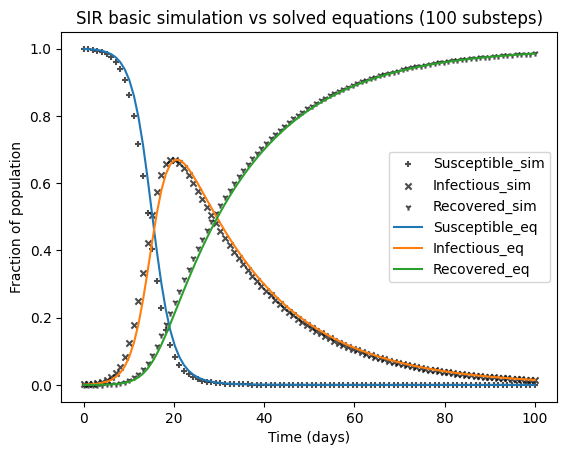

In [ ]:
"""
-----------------------------------------------------------------------------------------------
comparing results of agent-based model (substeps) with global contact simulation with numerical solution
-----------------------------------------------------------------------------------------------
"""

# simulation results
plt.scatter(time, s_sub / N, label="Susceptible_sim", marker="+", c="k", alpha=0.7, s=20)
plt.scatter(time, i_sub / N, label="Infectious_sim", marker="x", c="k", alpha=0.7, s=20)
plt.scatter(time, r_sub / N, label="Recovered_sim", marker="1", c="k", alpha=0.7, s=20)


# numerical solution
plt.plot(tArray_ivp, sArray_ivp / N, label="Susceptible_eq")
plt.plot(tArray_ivp, iArray_ivp / N, label="Infectious_eq")
plt.plot(tArray_ivp, rArray_ivp / N, label="Recovered_eq")


# plot options
plt.xlabel("Time (days)")
plt.ylabel("Fraction of population")
plt.title("SIR basic simulation vs solved equations (100 substeps)")
plt.legend()
plt.show()

## 2.3 Solver: Cellular Automata

Next we simulate the SIR problem using a cellular automaton.

 For computations we use a 2D grid
of size L. The value at each cell corresponds to a SIR state: susceptible (0), infectious (1), or recovered (2). In a simulation step we randomly transform each susceptible cell into infectious with probability $1-(1-\beta)^n$, where $n$ is the number of infectious cells in its nearest neighbourhood (von Neumann neighbourhood with periodic boundary conditions). At the same time we transform each infectious cell into recovered with probability $\gamma$.

This approach is advantageous when modelling disease dynamics in large systems or in general those in which the distribution of agents in space plays a deciding role.   

### Code

In [ ]:
"""
-------------------------------------------------------------------------
simulation - CELLULAR AUTOMATA
-------------------------------------------------------------------------
"""


def simulate_cellular_automata(L, I0, beta, gamma, t_start, t_finish):
    """
    A simulation - cellular automata model

    Parameters:
    - L: size of grid
    - I0: number of infectious at the beginning
    - beta: infection coefficient
    - gamma: recovery coefficient
    - t_start: selfcommented
    - t_finish: selfcommented

    Return:
    - sArray: number of susceptible in time
    - iArray: number of infectious in time
    - rArray: number of recovered in time
    - historyOfGrid: grid states obtained during the simulation
    """

    steps = int((t_finish - t_start))
    # initialize history of simulation states
    historyOfGrid = []
    sArray = np.zeros(steps, dtype=int)
    iArray = np.zeros(steps, dtype=int)
    rArray = np.zeros(steps, dtype=int)

    # initialization of 2D lattice of size L x L
    grid = np.zeros((L, L), dtype=np.uint8)
    N = L * L

    # random initialization of infected units
    infected_indices = np.random.choice(N, I0, replace=False)
    grid.flat[infected_indices] = 1

    # a kernel to get neighbours of x,y cell - von Neumann neighbourhood with periodic boundary conditions
    kernel = np.array([[0, 1, 0],
                       [1, 0, 1],
                       [0, 1, 0]], dtype=np.uint8)


    # simulation loop
    for step in range(steps):

        # saving current lattice state and SIR compartments to history
        historyOfGrid.append(grid.copy())
        counts = np.bincount(grid.ravel(), minlength=3)
        sArray[step], iArray[step], rArray[step] = counts[0], counts[1], counts[2]

        # get infected and susceptible agents
        infected = grid == 1
        susceptible = grid == 0

        # for each susceptible agent:
        # get number of infected neighbours
        infected_neighbors = convolve(infected.astype(np.uint8), kernel, mode="wrap")
        # get probability of becoming infected (indep. Bernoulli) and perform update according to that probability
        beta_eff = min(beta, 1)
        prob_infection = 1 - (1 - beta_eff) ** infected_neighbors
        rand_infect = np.random.rand(L, L)
        new_infections = (rand_infect < prob_infection) & susceptible

        # for each susceptible agent:
        # update to recovered according to the probability dictated by gamma parameter
        rand_recover = np.random.rand(L, L)
        recoveries = (rand_recover < gamma) & infected

        # update the lattice
        grid[new_infections] = 1
        grid[recoveries] = 2


    return sArray / N, iArray / N, rArray / N, historyOfGrid



def animate_CA(
    historyOfGrid, interval=100, max_frames=None, save_as="CA_simulation.gif"
):
    """
    ------------------------------------------------------------
    animates CA simulation and saves to a chosen file

    Parameters:
      historyOfGrid: CA grid states obtained during the simulation
      interval: delay between frames
      max_frames: how many states to animate
      save_as: name of the file to save the animation
    ------------------------------------------------------------
    """
    # assigning colors: S:blue, I:red, R:green
    cmap = ListedColormap(["blue", "red", "green"])
    bounds = [0, 1, 2, 3]
    norm = BoundaryNorm(bounds, cmap.N)

    # plot options
    fig, ax = plt.subplots()
    im = ax.imshow(historyOfGrid[0], cmap=cmap, norm=norm)
    cbar = plt.colorbar(im, ticks=[0.5, 1.5, 2.5], ax=ax)
    cbar.ax.set_yticklabels(["Susceptible (S)", "Infectious (I)", "Recovered (R)"])

    # update function for the use of matplotlib.animation.FuncAnimation
    def update(frame):
        im.set_data(historyOfGrid[frame])
        ax.set_title(f"Day {frame}")
        return [im]

    # check total number of frames
    if max_frames:
        total_frames = min(max_frames, len(historyOfGrid))
    else:
        total_frames = len(historyOfGrid)

    # animate and save
    ani = animation.FuncAnimation(
        fig, update, frames=total_frames, interval=interval, blit=True
    )
    ani.save(save_as, writer="pillow")
    plt.close()

In [ ]:
sArray, iArray, rArray, historyOfGrid = simulate_cellular_automata(
    L, I0, beta, gamma, t_start, t_finish
)

In [ ]:
animate_CA(historyOfGrid, interval=300)

### Results

#### Plot

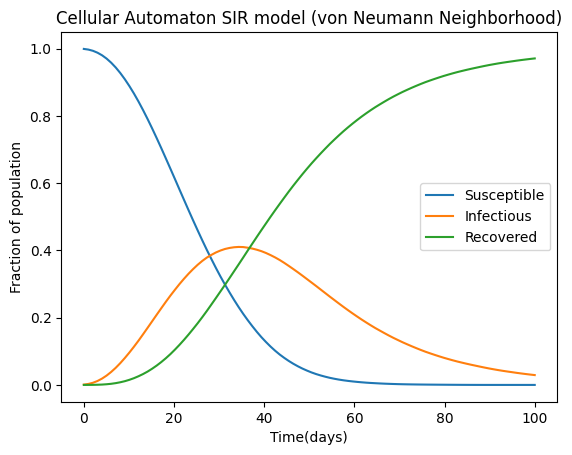

In [ ]:
plot(
    time,
    sArray,
    iArray,
    rArray,
    "Time(days)",
    "Cellular Automaton SIR model (von Neumann Neighborhood)",
)

#### Animation

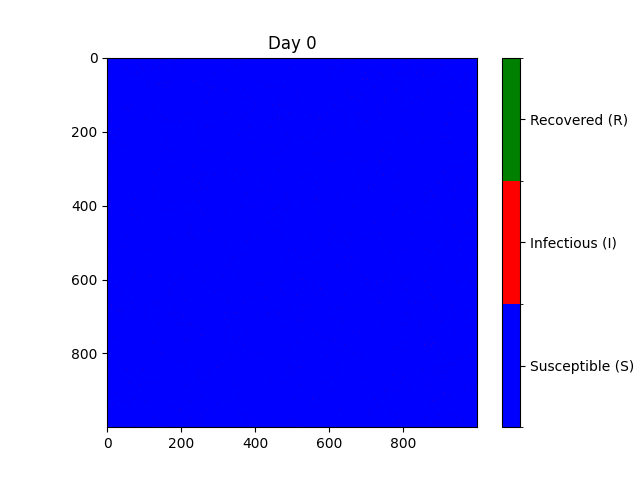

In [ ]:
Image('CA_simulation.gif')

## 2.4 Solver: Free Particles Model

### Description
In the end we simulate the SIR problem with a set of moving, particle-like agents in a box. At each time step the agents move randomly, and then their states are updated: the probabilities according to which we perform the update are calculated in the same way as in the CA simulation with the difference that this time the neighbourhood of agent means set of agents which are closer to that agent than some contact radius.

### Code

In [ ]:
"""
-----------------------------------------------------------------------------------------------
Free Particles Model
-----------------------------------------------------------------------------------------------
"""


@njit
def simulate_free_particles_model_numba(
    N=1000,
    fractionOfInfected=0.001,
    r_contact=0.04,
    v=0.01,
    beta=0.3,
    gamma=0.05,
    t_start=0,
    t_finish=100,
):
    """
    A simulation - free particles model (numba boosted)

    Parameters:
        - N: number of agents
        - fractionOfInfected: fraction of infected at the begining
        - r_contact (float): radius of contact, in which it is possible to be infected
        - v (float): velocity of agents
        - beta (float): infection coefficient
        - gamma (float): recovery coefficient
        - t_start (float): selfcommented
        - t_finish (float): selfcommented

    Return:
        - sArray, iArray, rArray: number of agents in state S, I, R in time
    """

    I0 = int(fractionOfInfected * N)
    days = int((t_finish - t_start))

    # initialization of initial agent positions (inside a 1 by 1 square)
    positions = np.random.rand(N, 2)

    # initialization of agent states: 0 = S, 1 = I, 2 = R
    agents = np.zeros(N, dtype=np.int32)
    agents[:I0] = 1
    np.random.shuffle(agents)

    # initialization of history of agent positions (separated for susceptible, infectious and recovered) and SIR compartments
    historyOfAgents_s = typed.List()
    historyOfAgents_i = typed.List()
    historyOfAgents_r = typed.List()

    sArray = np.zeros(days)
    iArray = np.zeros(days)
    rArray = np.zeros(days)

    # simulation loop
    for day in range(days):

        # save simulation state
        sArray[day] = np.count_nonzero(agents == 0)
        iArray[day] = np.count_nonzero(agents == 1)
        rArray[day] = np.count_nonzero(agents == 2)

        historyOfAgents_s.append(positions[agents == 0].copy())
        historyOfAgents_i.append(positions[agents == 1].copy())
        historyOfAgents_r.append(positions[agents == 2].copy())

        # random agent movement with periodic boundary conditions
        directions = np.random.rand(N, 2) - 0.5

        # normalization by hand (because a simple np.linalg.norm(axis=1) doesn't work in Numba)
        norms = np.empty((N, 1))
        for i in range(N):
            norms[i, 0] = (directions[i, 0] ** 2 + directions[i, 1] ** 2) ** 0.5
        positions += v * directions / norms
        positions %= 1.0

        # iteration over all agents
        for i in range(N):
            # if infectious check if recovery happens
            if agents[i] == 1 and np.random.rand() < gamma:
                agents[i] = 2
            # if susceptible
            elif agents[i] == 0:
                # iterate over all infectious agents
                for j in range(N):
                    if agents[j] != 1:
                        continue
                    # measure distance - check if the agents can interact - if so, check if infection happens
                    dx = np.abs(positions[i, 0] - positions[j, 0])
                    dx = min(dx, 1 - dx)
                    dy = np.abs(positions[i, 1] - positions[j, 1])
                    dy = min(dy, 1 - dy)
                    dist = (dx**2 + dy**2) ** 0.5
                    if dist < r_contact and np.random.rand() < beta:
                        agents[i] = 1
                        break



    return sArray / N, iArray / N, rArray / N, {'s':historyOfAgents_s, 'i':historyOfAgents_i, 'r':historyOfAgents_r}


def animate_particles(
    historyOfAgents,
    interval=100,
    max_frames=100,
    save_as="particles_simulation.gif",
    radius=0.01,
):
    """
    ------------------------------------------------------------
    animates free particle simulation and saves to a chosen file

    Parameters:
      - historyOfAgents: agent states obtained during the simulation
      - interval: delay between frames
      - max_frames: how many states to animate
      - save_as: name of the file to save the animation
      - radius: radius of the circle representing infectious radius around incfectious agents
    ------------------------------------------------------------
    """

    # plot options
    fig, ax = plt.subplots()
    ax.set_xlim(0, 1)
    ax.set_ylim(0, 1)
    ax.set_aspect("equal")
    ax.set_title("Agent-based SIR simulation (early phase)")

    total_frames = min(max_frames, len(historyOfAgents["s"]))

    # Maximum number of agents from the entire history – needed to initialize a sufficient number of circles
    max_s = max(len(s) for s in historyOfAgents["s"])
    max_i = max(len(i) for i in historyOfAgents["i"])
    max_r = max(len(r) for r in historyOfAgents["r"])

    # Create circles (dots and larger ones with r_contact radius)
    circles_s = [
        plt.Circle((0, 0), 0.005, color="blue", alpha=1, visible=False)
        for _ in range(max_s)
    ]
    circles_i = [
        plt.Circle((0, 0), 0.005, color="red", alpha=1, visible=False)
        for _ in range(max_i)
    ]
    circles_i_radius = [
        plt.Circle((0, 0), radius, color="red", alpha=0.3, visible=False)
        for _ in range(max_i)
    ]
    circles_r = [
        plt.Circle((0, 0), 0.005, color="green", alpha=1, visible=False)
        for _ in range(max_r)
    ]

    for c in circles_s + circles_i + circles_i_radius + circles_r:
        ax.add_patch(c)

    # Update visible circles
    def update(frame):
        s_pos = np.array(historyOfAgents["s"][frame]).reshape(-1, 2)
        i_pos = np.array(historyOfAgents["i"][frame]).reshape(-1, 2)
        r_pos = np.array(historyOfAgents["r"][frame]).reshape(-1, 2)

        # Suseptible (S) - blue dots
        for i, c in enumerate(circles_s):
            if i < len(s_pos):
                c.center = tuple(s_pos[i])
                c.set_visible(True)
            else:
                c.set_visible(False)
        # Infected (I) - red dots + red circles
        for i, (c, r) in enumerate(zip(circles_i, circles_i_radius)):
            if i < len(i_pos):
                c.center = tuple(i_pos[i])
                r.center = tuple(i_pos[i])
                c.set_visible(True)
                r.set_visible(True)
            else:
                c.set_visible(False)
                r.set_visible(False)

        # Recovered (R) - green dots
        for i, c in enumerate(circles_r):
            if i < len(r_pos):
                c.center = tuple(r_pos[i])
                c.set_visible(True)
            else:
                c.set_visible(False)

        ax.set_title(f"Day {frame}")
        return circles_s + circles_i + circles_i_radius + circles_r

    # create animation and save
    ani = animation.FuncAnimation(
        fig, update, frames=total_frames, interval=interval, blit=True
    )
    ani.save(save_as, writer="pillow")
    plt.close()


def animate_sir_simulation(
    param_name="N",
    param_values=None,
    fixed_params=None,
    beta=0.3,
    gamma=0.1,
    t_start=0,
    t_finish=100,
    n_runs=10,
    filename="animation.gif",
):
    """
    Creates an animated line plot of the SIR model with particle movement under varying values of a chosen parameter.

    param_name: name of the varying parameter ('N', 'I0', 'r_contact', 'v')
    param_values: list of values that the varying parameter should take
    fixed_params: dictionary with other parameters, e.g., {'N': 1000, 'I0': 10, 'r_contact': 0.02, 'v': 0.01}
    beta, gamma: infection and recovery parameters
    days: number of simulation days
    n_runs: number of times to run each simulation to average the results
    """
    days = int(t_finish - t_start)
    if fixed_params is None:
        fixed_params = {"N": 1000, "I0": 0.001, "r_contact": 0.02, "v": 0.01}

    fig, ax = plt.subplots()
    (line_s,) = ax.plot([], [], label="Susceptible", color="blue")
    (line_i,) = ax.plot([], [], label="Infectious", color="red")
    (line_r,) = ax.plot([], [], label="Recovered", color="green")

    ax.set_xlim(0, days)
    ax.set_ylim(0, 1.0)
    ax.set_xlabel("Time (days)")
    ax.set_ylabel("Fraction of population")
    # ax.legend()

    time = list(range(days))
    title = ax.set_title("")

    def init():
        line_s.set_data([], [])
        line_i.set_data([], [])
        line_r.set_data([], [])
        title.set_text("")
        return line_s, line_i, line_r, title

    def update(frame):
        value = param_values[frame]
        params = fixed_params.copy()
        params[param_name] = value

        N = params["N"]
        I0 = params["I0"]

        s_total = np.zeros(days)
        i_total = np.zeros(days)
        r_total = np.zeros(days)

        for _ in range(n_runs):
            sArray, iArray, rArray,_n = simulate_free_particles_model_numba(
                N, I0, params["r_contact"], params["v"], beta, gamma, t_start, t_finish
            )
            s_total += np.array(sArray)
            i_total += np.array(iArray)
            r_total += np.array(rArray)

        s_avg = s_total / n_runs
        i_avg = i_total / n_runs
        r_avg = r_total / n_runs

        line_s.set_data(time, s_avg)
        line_i.set_data(time, i_avg)
        line_r.set_data(time, r_avg)
        title.set_text(f"{param_name} = {value:.4f}")
        return line_s, line_i, line_r, title

    ani = animation.FuncAnimation(
        fig, update, frames=len(param_values), init_func=init, blit=True, repeat=False
    )
    ani.save(filename, writer="pillow")
    plt.close(fig)

In [ ]:
N = 3000
fractionOfInfected = 0.001
r_contact = 0.02
v = 0.01
sArray, iArray, rArray, historyOfAgents = simulate_free_particles_model_numba(
    N, fractionOfInfected, r_contact, v, beta, gamma, t_start, t_finish
)


In [ ]:
animate_particles(historyOfAgents, interval=100, radius = r_contact)

In [ ]:
steps = 50
runs = 40
animate_sir_simulation(
    param_name="N",
    param_values=np.linspace(1000, 3000, steps).astype(int),
    fixed_params={"I0": 0.001, "r_contact": 0.02, "v": 0.01},
    beta=0.3,
    gamma=0.1,
    t_start=t_start,
    t_finish=t_finish,
    n_runs=runs,
    filename="N_simulation.gif",
)
print("Simulation with varying N completed.")
animate_sir_simulation(
    param_name="r_contact",
    param_values=np.linspace(0.01, 0.03, steps),
    fixed_params={"N": 2000, "I0": 0.001, "v": 0.01},
    beta=0.3,
    gamma=0.1,
    t_start=t_start,
    t_finish=t_finish,
    n_runs=runs,
    filename="r_simulation.gif",
)
print("Simulation with varying r_contact completed.")
animate_sir_simulation(
    param_name="v",
    param_values=np.linspace(0.005, 0.03, steps),
    fixed_params={"N": 2000, "I0": 0.001, "r_contact": 0.02},
    beta=0.3,
    gamma=0.1,
    t_start=t_start,
    t_finish=t_finish,
    n_runs=runs,
    filename="v_simulation.gif",
)
print("Simulation with varying v completed.")
animate_sir_simulation(
    param_name="I0",
    param_values=np.linspace(0.001, 0.1, steps),
    fixed_params={"N": 2000, "r_contact": 0.02, "v": 0.01},
    beta=0.3,
    gamma=0.1,
    t_start=t_start,
    t_finish=t_finish,
    n_runs=runs,
    filename="I0_simulation.gif",
)
print("Simulation with varying I0 completed.")

Simulation with varying N completed.
Simulation with varying r_contact completed.
Simulation with varying v completed.
Simulation with varying I0 completed.


### Results

#### Plot

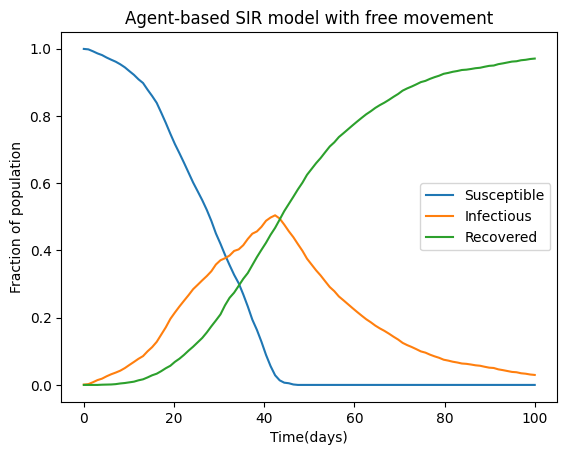

In [ ]:
plot(time, sArray, iArray, rArray, 'Time(days)', 'Agent-based SIR model with free movement')

#### Animation

##### Free Particles Simulation

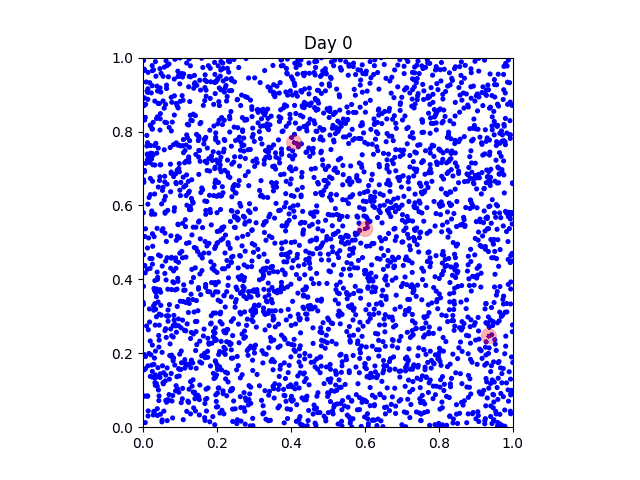

In [ ]:
Image("particles_simulation.gif")

##### Evolution of the model with an increasing number of particles (agents)

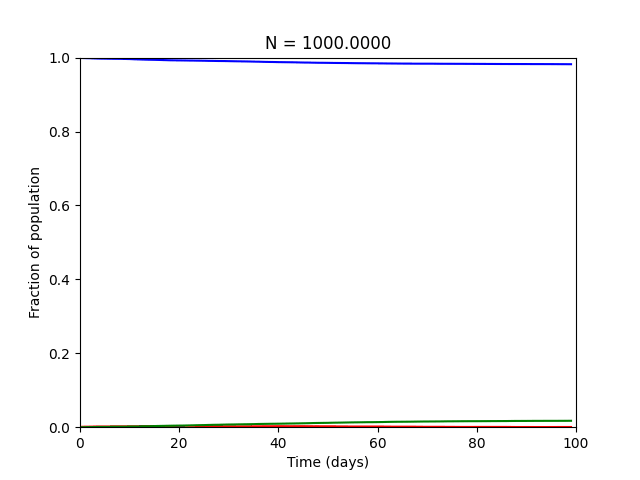

In [ ]:
Image("N_simulation.gif")

##### Evolution of the model with an increasing infection radius

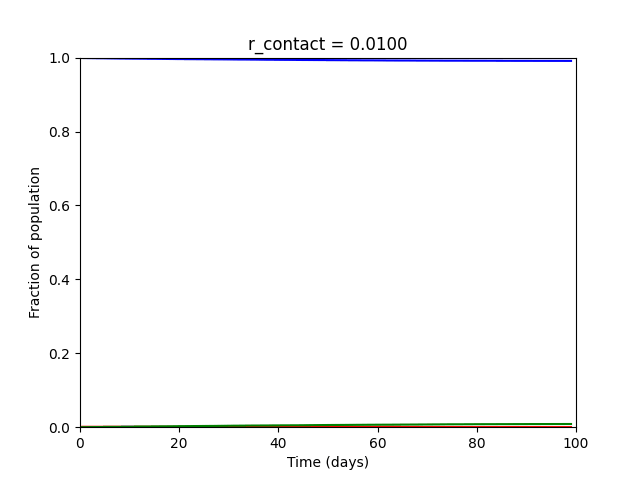

In [ ]:
Image("r_simulation.gif")

##### Evolution of the model with an increasing velocity of moving particles

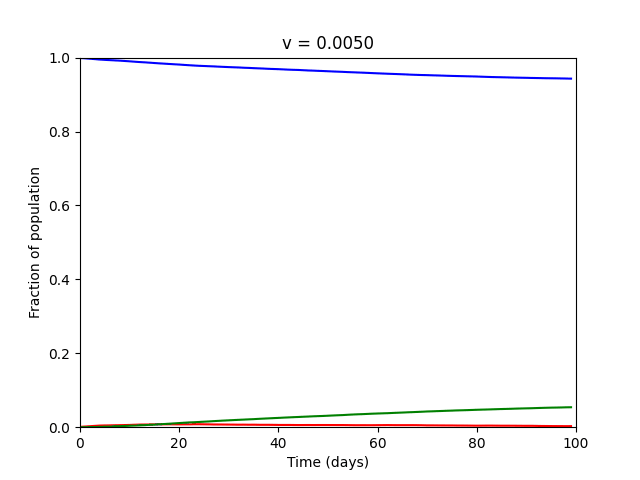

In [ ]:
Image("v_simulation.gif")

##### Evolution of the model with increasing initial infection rate ($I_0$)

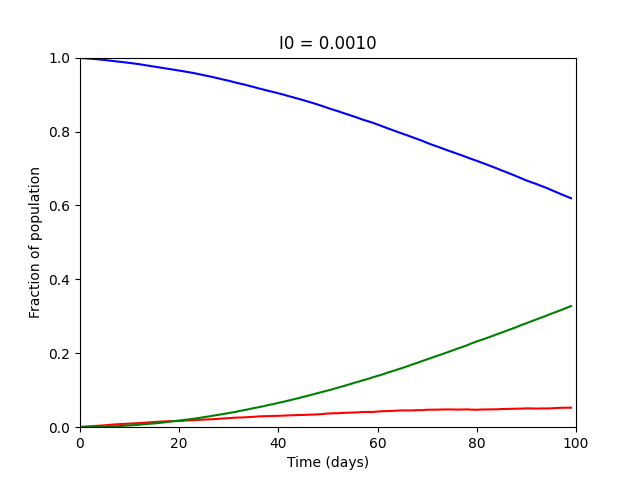

In [ ]:
Image("I0_simulation.gif")